# Audio Coding



## Lossless Audio Coding
Lossless audio coding techniques reduce the size of audio signals using redundancy reduction, such as sample value distribution. This means such techniques may not reduce much if a signal doesn't have much redundant signals such as white noise. In average, most techniques compresses about 50% of the input signals. The original signal values can be obtained by decoding, hence the name *lossless*. Popular lossless methods include Shorten, FLAC, Window Media Audio 9 Lossless and etc.

There are many purposes for lossless audio coding. Here we list some of the most important usecases:

- Archiving
- Studio operations
- Digital music distribution over the Internet
- Portable music players/recorders
- Multi-channel audio. e.g. DVD-audio
- Bluetooth audio

### Principles of lossless audio coding
A lossless audio coding method is comprised of three main blocks:
1. Framing $\rightarrow$ Divides the audio signal into frames, e.g. 100ms
2. Decorrelation $\rightarrow$ Removes redundancy (spectral whitening)
3. Entropy encoding $\rightarrow$ Statistically efficient code book
    - The histogram of audio signals is often close to Laplace distribution
    - Short code for common sample values
    - Long code for rare sample values
    
For **decorrelation**, there are two approaches:
1. Linear **predictive** model
    - Lossless representation $\rightarrow$ **Predictor** coefficients + Error signal
2. Linear **transform** model
    - Lossless representation $\rightarrow$ **Transform** coefficients + Error signal
    
    
![lossless_codecs_comparison](images/lossless_codecs_comparison.png)



-----------

## Lossy(perceptual) Audio Coding
Lossy audio coding reduces the size of audio using irrelevancy reduction. The irrelevant signals are signals which are beyond the hearing range of majority of people. Contrary to lossless audio coding, the original values cannot be retrieved by decoding. Such techniques include MPEG Audio(Layer 1,2,3), Ogg Vorbis, WMA and etc. Lossy techniques are mainly meant for end user applications such as music/audio streaming services, digital TV/radio and movie soundtracks.

![mp3_audio_at_various_bit_rates](images/mp3_audio_at_various_bit_rates.png)

-----------------

## Analysis
We analyze MP3 audio at various bit-rates. Our target audio is *Poker face* by Lady Gaga. The WAV file was ripped from an original CD. We used iTunes for MP3 conversion. iTunes allow following options for conversion:

![itunes_setting](images/itunes_setting.png)

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 18   # Time and Hz, i.e. labels
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.labelsize'] = 18  # Time(x) tick values
plt.rcParams['ytick.labelsize'] = 18  # Hz(y) tick values
plt.rcParams['legend.fontsize'] = 17
plt.rcParams['figure.titlesize'] = 20
plt.rcParams['axes.titlesize'] = 20   # Title font
import numpy as np
from IPython.display import Audio, display
from scipy.io import wavfile
from scipy.signal import freqz, lfilter
import math
import librosa

def is_stereo(ys):
    return len(ys.shape) == 2

def display_audio(ys, fs=44100):
    if is_stereo(ys) and ys.shape[1] == 2:
        ys = ys.T
    display(Audio(ys, rate=fs))

In [2]:
%ls data

poker_face_128.mp3  poker_face_192.mp3  poker_face_320.mp3  tonight.wav
poker_face_160.mp3  poker_face_256.mp3  poker_face_wav.wav


In [10]:
bitrates = '128,160,192,256,320'.split(',')
FS = 44100
audio_wav = librosa.load('data/poker_face_wav.wav', sr=FS, mono=True, offset=40, duration=30)[0]
audios_mp3 = [
    librosa.load(
        f'data/poker_face_{bitrate}.mp3', 
        sr=FS, 
        mono=True, 
        offset=40, 
        duration=30
    )[0] for bitrate in bitrates]


### Listening Analysis

In [7]:
print("Wav file")
display_audio(audio_wav)

Wav file


In [11]:
for bitrate, ys in zip(bitrates, audios_mp3):
    print(f"MP3 audio in {bitrate} kbps")
    display_audio(ys)

MP3 audio in 128 kbps


MP3 audio in 160 kbps


MP3 audio in 192 kbps


MP3 audio in 256 kbps


MP3 audio in 320 kbps


### Spectrogram analysis

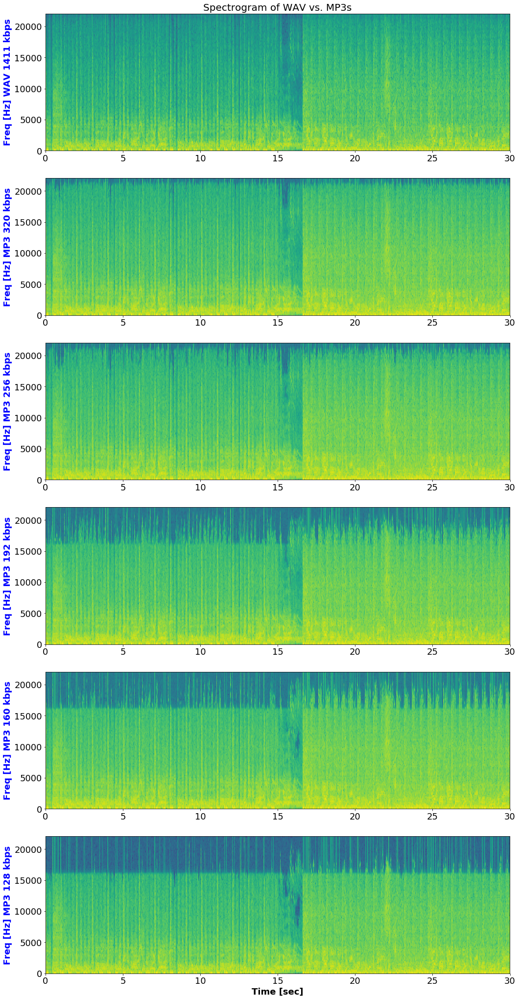

In [23]:
f, axarr = plt.subplots(6, sharey=True, figsize=(17, 36))
# Plot Source
axarr[0].specgram(audio_wav, Fs=FS)
axarr[0].set_ylabel('Freq [Hz] WAV 1411 kbps', color='blue')
axarr[0].set_title('Spectrogram of WAV vs. MP3s')

for i, ys, bitrate in zip(range(1, 6), reversed(audios_mp3), reversed(bitrates)):
    # Plot Filtered
    axarr[i].specgram(ys, Fs=FS)
    axarr[i].set_ylabel(f'Freq [Hz] MP3 {bitrate} kbps', color='blue')
    plt.xlabel('Time [sec]')

## Discussions

We analyzed WAV and MP3 files at various bit-rates. The loss in low bit-rate MP3s are vivid on spectrogram, but the listening experience is not inferior compared to the WAV. Therefore, we could conclude that MP3 successfully compresses audio without a significant perceptual loss.